In [113]:
# For version check
from platform import python_version
from importlib.metadata import version

In [114]:
# import libraries:

import pandas as pd
import matplotlib.cm as cm
import matplotlib.pyplot as plt
import networkx as nx

In [115]:
print('Python: ', python_version())

print('pandas: ', pd.__version__)
print('networkx: ', nx.__version__)
print('matplotlib: ', version('matplotlib'))

Python:  3.10.1
pandas:  1.4.2
networkx:  2.8
matplotlib:  3.5.2


# 1. GRNs exploring with NetworkX
Explore the three GRNs with NetworkX. Networks are presented in adjacency list format.

Info about NetworkX:
1. [Docs](https://networkx.org/documentation/stable/tutorial.html)
2. [Tutorial Datacamp](https://www.datacamp.com/community/tutorials/networkx-python-graph-tutorial)
3. [Tutorial](https://www.cl.cam.ac.uk/teaching/1314/L109/tutorial.pdf)
4. [Medium](https://medium.com/tag/networkx)


## Contents:
1. [Yeasts GRN](#Yeast_NetworkX).\
   1.1. [Yeasts graph metrics](#yest_metrics).
   
2. [Mouse GRN](#Mouse_NetworkX).\
   2.1. [Mouse graph metrics](#mouse_metrics).

3. [Human GRN](#Human_NetworkX).\
   3.1. [Human graph metrics](#human_metrics).


## 1. Yeast GRN <a name="Yeast_NetworkX"></a>

Data from Balaji, Santhanam, et al. "Comprehensive analysis of combinatorial regulation using the transcriptional regulatory network of yeast." Journal of molecular biology 360.1 (2006): 213-227.

In [4]:
# load GRN
yeast_data = pd.read_csv('../data/01_GRNs/yeast.txt', sep='\t')
print(yeast_data.shape)
yeast_data.head()

(12873, 2)


,Tf,Tg
0,YAL051W,YAL016W
1,YAL051W,YAL034WA
2,YAL051W,YAL035CA
3,YAL051W,YAL035W
4,YAL051W,YAL036C


In [101]:
# create nx graph
yeast_graph = nx.from_pandas_edgelist(yeast_data, 
                                      source='Tf', target='Tg', 
                                      create_using=nx.DiGraph())

# or:
#for i, elrow in yeast_data.iterrows():
#    yeast_graph.add_edge(elrow[0], elrow[1], attr_dict=elrow[2:].to_dict())

print('# of edges: {}'.format(yeast_graph.number_of_edges()))
print('# of nodes: {}'.format(yeast_graph.number_of_nodes()))
print('Average number of neighbors for nodes: {}'.format(round(yeast_graph.number_of_edges() / float(yeast_graph.number_of_nodes()), 4)))

# of edges: 12873
# of nodes: 4441
Average number of neighbors for nodes: 2.8987


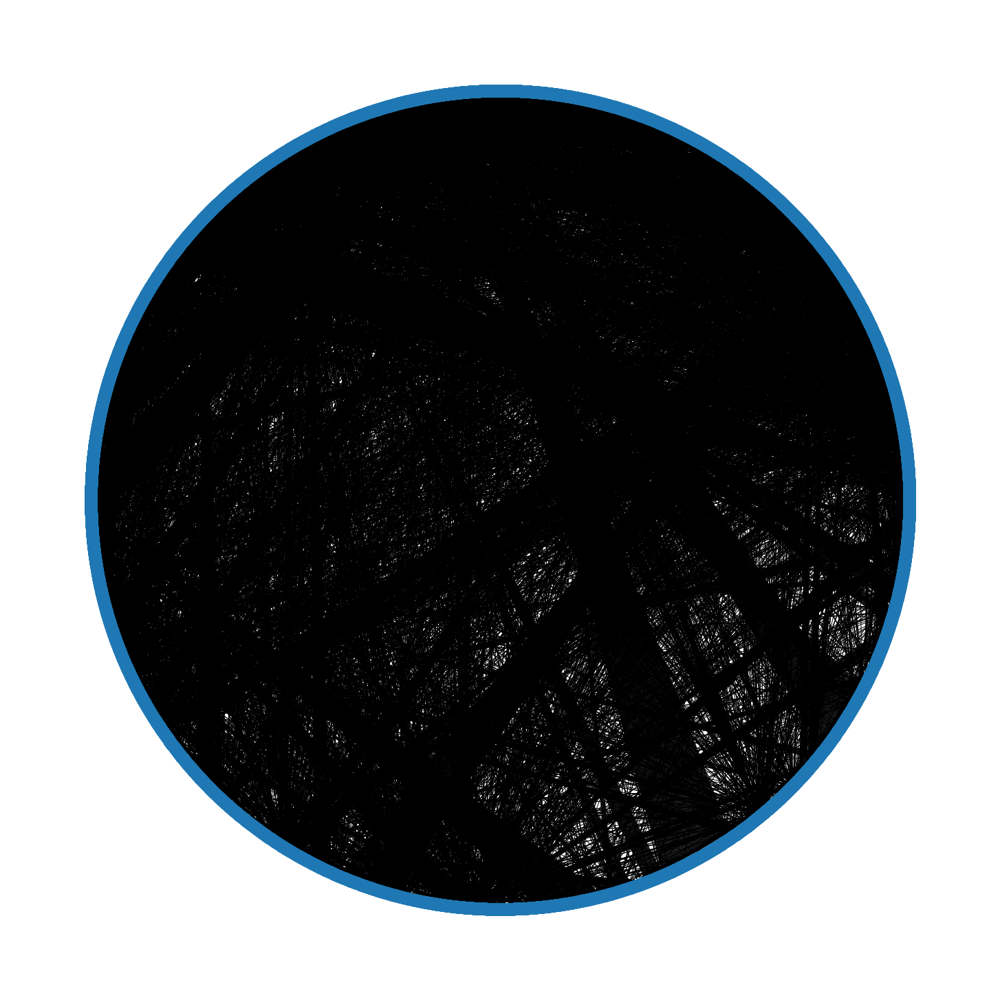

In [76]:
# simple graph plot
plt.figure(figsize=(20, 20))
pos = nx.circular_layout(yeast_graph)
nx.draw(yeast_graph, pos)
plt.show()
# plt.savefig('../data/01_graph_plots/yeast_plot_01.png')
# plt.close()

## 1.1. Yeasts graph metrics <a name="yeast_metrics"></a>

In [9]:
# degree_pearson_correlation_coefficient
print(nx.degree_pearson_correlation_coefficient(yeast_graph))

-0.173374940709752


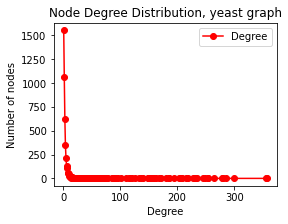

In [96]:
# Node Degree and Node Degree Distribution
# degree - the number of nearest neighbors of this node

degree = dict(yeast_graph.degree())
degree_values = sorted(set(degree.values()))

hist = [list(degree.values()).count(x) for x in degree_values]

plt.figure(figsize=(4, 3))
plt.plot(degree_values, hist, 'ro-')
plt.legend(['Degree'])
plt.xlabel('Degree')
plt.ylabel('Number of nodes')
plt.title('Node Degree Distribution, yeast graph')
plt.show()
#plt.savefig('../data/01_graph_plots/plot_09.png')
#plt.close()

## 2. Mouse GRN  <a name="Mouse_NetworkX"></a>
Data from [TRRUST (version 2)](https://www.grnpedia.org/trrust/)

In [13]:
mouse_data = pd.read_csv('../data/01_GRNs/trrust_rawdata.mouse.tsv', 
                         sep='\t', header=None, 
                         names=['TF', 'Target', 'Mode', 'PMID'])
print(mouse_data.shape)
mouse_data.head()

(7057, 4)


,TF,Target,Mode,PMID
0,Aatf,Bak1,Unknown,22983126
1,Aatf,Bax,Unknown,22983126
2,Aatf,Bbc3,Unknown,22983126
3,Aatf,Cdkn1a,Unknown,21317046
4,Aatf,Tpt1,Activation,17157788


In [100]:
# create nx graph
mouse_graph = nx.from_pandas_edgelist(mouse_data, 'TF', 'Target', ['Mode', 'PMID'], 
                                      create_using=nx.DiGraph())

print('# of edges: {}'.format(mouse_graph.number_of_edges()))
print('# of nodes: {}'.format(mouse_graph.number_of_nodes()))
print('Average number of neighbors for nodes: {}'.format(round(mouse_graph.number_of_edges() / float(mouse_graph.number_of_nodes()), 4)))

# of edges: 6490
# of nodes: 2456
Average number of neighbors for nodes: 2.6425


In [73]:
color_map_mouse = []

for node in mouse_graph.edges(data=True):
    
    if node[2]['Mode'] == 'Activation':
        color_map_mouse.append('green')
        
    elif node[2]['Mode'] == 'Repression':
        color_map_mouse.append('red')
    
    else: 
        color_map_mouse.append('#E0E0E0')    
        

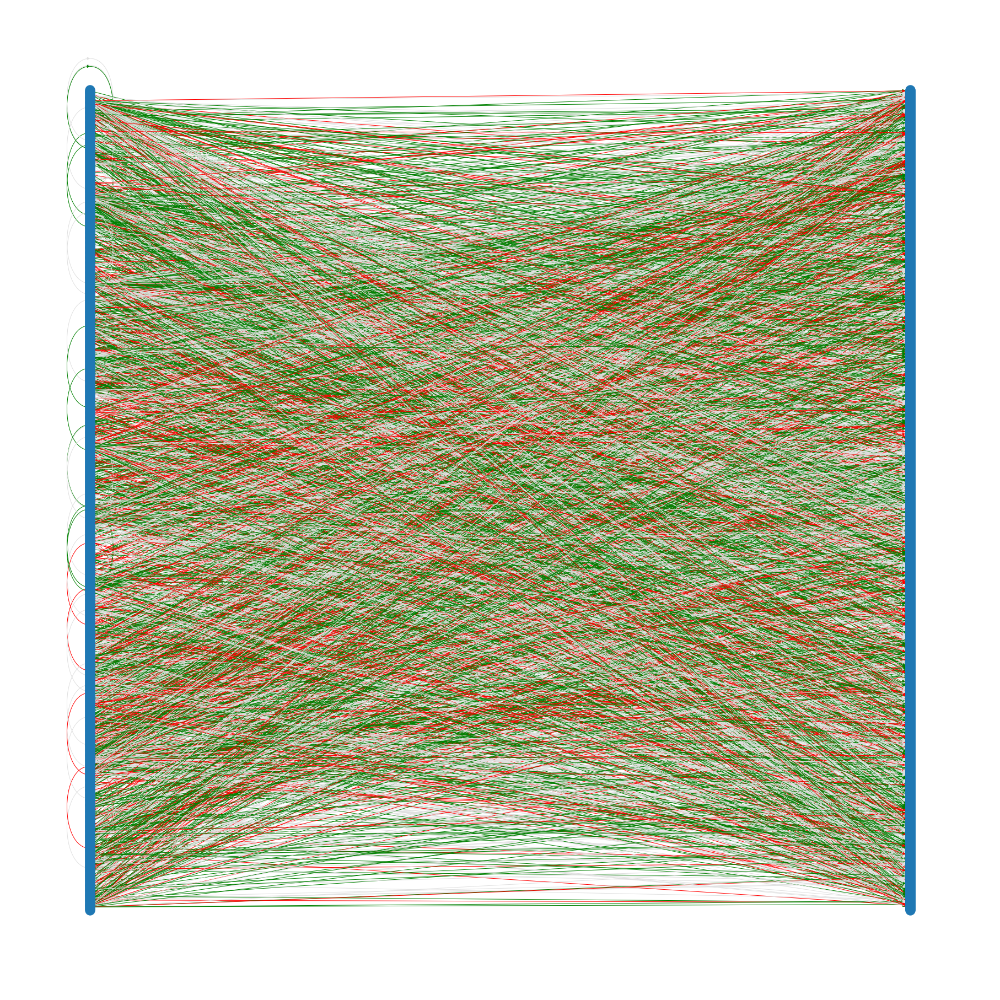

In [74]:
# plot TF and Target on different sides of plot

plt.figure(figsize=(25, 25))
pos = nx.bipartite_layout(mouse_graph, list(set(mouse_data.TF)))
nx.draw(mouse_graph, pos, edge_color=color_map_mouse)
plt.show()
#plt.savefig('../data/01_graph_plots/mouse_plot_01.png')
#plt.close()

## 2.1. Mouse graph metrics <a name="mouse_metrics"></a>

In [46]:
# degree_pearson_correlation_coefficient
print(nx.degree_pearson_correlation_coefficient(mouse_graph))

-0.07851964550247582


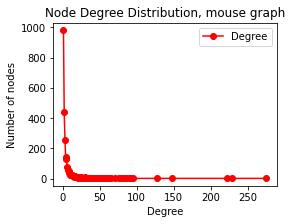

In [97]:
# Node Degree and Node Degree Distribution
# degree - the number of nearest neighbors of this node

degree = dict(mouse_graph.degree())
degree_values = sorted(set(degree.values()))

hist = [list(degree.values()).count(x) for x in degree_values]

plt.figure(figsize=(4, 3))
plt.plot(degree_values, hist, 'ro-')
plt.legend(['Degree'])
plt.xlabel('Degree')
plt.ylabel('Number of nodes')
plt.title('Node Degree Distribution, mouse graph')
plt.show()
#plt.savefig('../data/01_graph_plots/plot_09.png')
#plt.close()

## 3. Human GRN <a name="Human_NetworkX"></a>

In [55]:
human_data = pd.read_csv('../data/01_GRNs/trrust_rawdata.human.tsv', 
                         sep='\t', header=None, 
                         names=['TF', 'Target', 'Mode', 'PMID'])
print(human_data.shape)
human_data.head()

(9396, 4)


,TF,Target,Mode,PMID
0,AATF,BAX,Repression,22909821
1,AATF,CDKN1A,Unknown,17157788
2,AATF,KLK3,Unknown,23146908
3,AATF,MYC,Activation,20549547
4,AATF,TP53,Unknown,17157788


In [99]:
# create nx graph
human_graph = nx.from_pandas_edgelist(human_data, 'TF', 'Target', ['Mode', 'PMID'], create_using=nx.DiGraph())

print('# of edges: {}'.format(human_graph.number_of_edges()))
print('# of nodes: {}'.format(human_graph.number_of_nodes()))
print('Average number of neighbors for nodes: {}'.format(round(human_graph.number_of_edges() / float(human_graph.number_of_nodes()), 4)))

# of edges: 8427
# of nodes: 2862
Average number of neighbors for nodes: 2.9444


In [59]:
color_map = []

for node in human_graph.edges(data=True):
    
    if node[2]['Mode'] == 'Activation':
        color_map.append('green')
        
    elif node[2]['Mode'] == 'Repression':
        color_map.append('red')
    
    else: 
        color_map.append('#E0E0E0')    
        

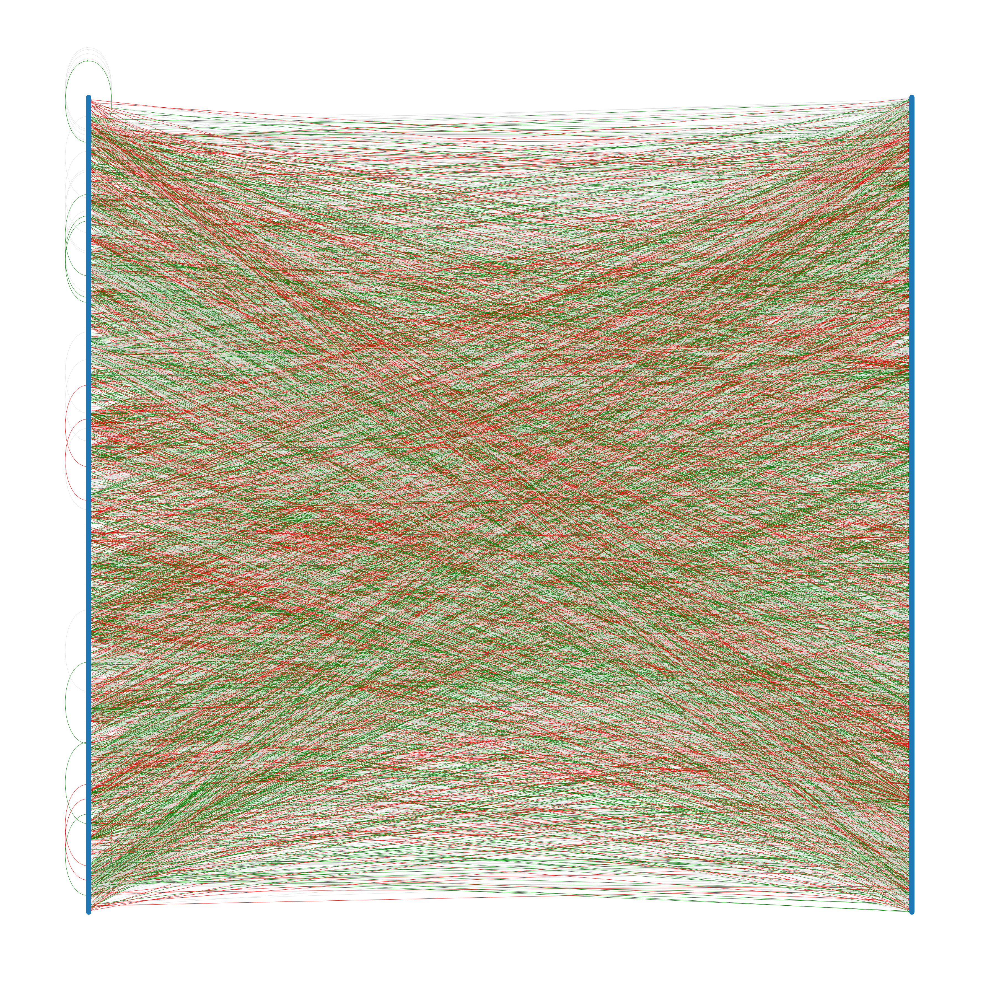

In [62]:
# plot TF and Target on different sides of plot

plt.figure(figsize=(50, 50))
pos = nx.bipartite_layout(human_graph, list(set(human_data.TF)))
nx.draw(human_graph, pos, edge_color=color_map)
plt.show()
#plt.savefig('../data/01_graph_plots/human_plot_01.png')
#plt.close()

## 3.1. Human graph metrics <a name="human_metrics"></a>

In [82]:
# degree_pearson_correlation_coefficient
print(nx.degree_pearson_correlation_coefficient(human_graph))

-0.10713999735086951


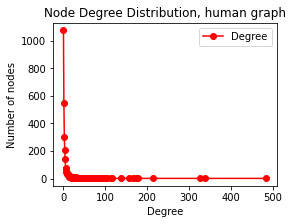

In [94]:
# Node Degree and Node Degree Distribution
# degree - the number of nearest neighbors of this node

degree = dict(human_graph.degree())
degree_values = sorted(set(degree.values()))

hist = [list(degree.values()).count(x) for x in degree_values]

plt.figure(figsize=(4, 3))
plt.plot(degree_values, hist, 'ro-')
plt.legend(['Degree'])
plt.xlabel('Degree')
plt.ylabel('Number of nodes')
plt.title('Node Degree Distribution, human graph')
plt.show()
#plt.savefig('../data/01_graph_plots/human_plot_02.png')
#plt.close()

# Notes

1. You can export network data and draw with other programs (GraphViz, Gephi, etc.).
2. https://habr.com/ru/company/dca/blog/265077/
3. https://habr.com/ru/company/dca/blog/264811/
4. https://habr.com/ru/post/516514/